<center>

<h1 style="font-size: 40px;">Evolutionary Algorithm</h1>

</center>

The aim of the exercise is to implement an evolutionary algorithm with:
- Tournament selection $(\mathrm{k}=2)$
- Single-point crossover
- Gaussian mutation
- Generational succession

Then, you should utilize the implementation to find a solution minimizing the sum of $f_1$ and $f_2$ defined as follows:
$$
f_1\left(x_1, y_1\right)=\left(x_1^2+y_1-11\right)^2+\left(x_1+y_1^2-7\right)^2
$$
and
$$
f\left(x_2, y_2\right)=2 \cdot x_2^2+1.05 \cdot x_2^4+\frac{x_2^6}{6}+x_2 y_2+y_2^2
$$
in both cases for the domain $D=[-5,5] \times[-5,5]$.
You need to find a set of hyperparameters that gives relatively good results, then investigate the influence of:
- Initial population distribution (hint: consider two cases - uniform distribution over the entire domain and normal distribution around $\left[x_1=-0.3, y_1=-0.9\right]$ and arbitrarily chosen for $f_2$)
- Mutation probabilities (within a reasonable range)
- Crossover probability (within the range of $0.8$ to $0.95$)

on the coordinates of the found minima for the function $f_1$. It's also valuable to visualize, using plots, the distribution of populations at different optimization stages, divided into appropriate functions.

In [51]:
%pip install matplotlib
%pip install pandas
%pip install numpy
%pip install ipython
%pip install ipympl
%pip install tabulate
%pip install ipywidgets
%pip install ffmpeg
%matplotlib widget

import random
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.animation as animation
import numpy as np
from IPython.display import HTML

/bin/bash: warning: setlocale: LC_ALL: cannot change locale (en_US.UTF-8)
Defaulting to user installation because normal site-packages is not writeable
Note: you may need to restart the kernel to use updated packages.
/bin/bash: warning: setlocale: LC_ALL: cannot change locale (en_US.UTF-8)
Defaulting to user installation because normal site-packages is not writeable
Note: you may need to restart the kernel to use updated packages.
/bin/bash: warning: setlocale: LC_ALL: cannot change locale (en_US.UTF-8)
Defaulting to user installation because normal site-packages is not writeable
Note: you may need to restart the kernel to use updated packages.
/bin/bash: warning: setlocale: LC_ALL: cannot change locale (en_US.UTF-8)
Defaulting to user installation because normal site-packages is not writeable
Note: you may need to restart the kernel to use updated packages.
/bin/bash: warning: setlocale: LC_ALL: cannot change locale (en_US.UTF-8)
Defaulting to user installation because normal site-pa

# Define the functions to be optimized


In [52]:
def f1(xy):
    return (xy[0] ** 2 + xy[1] - 11) ** 2 + (xy[0] + xy[1] ** 2 - 7) ** 2

In [53]:
def f2(xy):
    return 2 * xy[0] ** 2 + 1.05 * xy[0] ** 4 + xy[0] ** 6 / 6 + xy[0] * xy[1] + xy[1] ** 2

# Create a function that returns the sum of the two functions to be optimized

In [54]:
def f(xy):
    return f1(xy[:2]) + f2(xy[-2:])

# Define the basic variables for the functions
- bounds
- number of generations $t_{max}$
- tournament size

In [55]:
bounds = [(-5, 5), (-5, 5)]
tournament_size = 2
gauss_vec = [-0.3, -0.9]

# Create a initial population

In [56]:
def init_population(pop_size, bounds, gauss=False):
    # Create random population
    population = []
    for i in range(pop_size):
        # if gauss is True, use gauss distribution, else use uniform distribution
        if not gauss:
            individual1 = [random.uniform(bounds[j][0], bounds[j][1]) for j in range(len(bounds))]
        else:
            individual1 = [random.gauss(gauss_vec[j], 1) for j in range(len(bounds))]
        individual2 = [random.uniform(bounds[j][0], bounds[j][1]) for j in range(len(bounds))]
        population.append(individual1 + individual2)
    return population

# Calculate fitness values for each individual in the population

In [57]:
def calculate_fitness(population):
    fitness = []
    for individual in population:
        fitness.append(f(individual))
    return fitness

# Select the parents for the next generation using tournament selection

In [58]:
def selection(population, fitness, tournament_size):
    # Select the parents for the next generation using tournament selection
    # Each individual competes with 'tournament_size' other individuals
    parents = []
    for i in range(len(population)):
        tournament = random.sample(range(len(population)), tournament_size)
        tournament_fitness = [fitness[j] for j in tournament]
        winner = tournament[tournament_fitness.index(min(tournament_fitness))]  # index of the winner
        parents.append(population[winner])  # add the winner to the mating pool
    return parents

# One-point crossover

In [59]:
def crossover(parents, crossover_rate):
    parent1 = random.choice(parents)
    parent2 = random.choice(parents)
    if random.random() < crossover_rate:
        crossover_point = random.randint(0, 3)
        child = parent1[:crossover_point] + parent2[crossover_point:]
    else:
        child = parent2
    return child

# Gaussian mutation

In [60]:
def mutation(child, gauss_sigma, mutation_rate):
    for i in range(len(child)):
        if random.random() < mutation_rate:
            child[i] += random.gauss(0, gauss_sigma)
    return child

# Create the offspring for the next generation using crossover and mutation

In [61]:
def create_offspring(parents, gauss_sigma, mutation_rate, crossover_rate):
    offspring = []
    for i in range(len(parents)):
        child = crossover(parents, crossover_rate)
        child = mutation(child, gauss_sigma, mutation_rate)
        offspring.append(child)
    return offspring

# Define the main loop for the evolutionary algorithm

In [62]:
def evolutionary_algorithm(population, bounds, num_generations, tournament_size, gauss_sigma, mutation_rate, crossover_rate):
    population_states = []
    for generation in range(num_generations):
        # Evaluate the fitness of each individual in the population
        fitness = calculate_fitness(population)

        # Select the parents for the next generation using tournament selection
        parents = selection(population, fitness, tournament_size)

        # Create the offspring for the next generation using crossover and mutation
        offspring = create_offspring(parents, gauss_sigma, mutation_rate, crossover_rate)

        # Replace the old population with the new offspring
        population = offspring

        # Save the population for the animation
        df = pd.DataFrame(population, columns=['x1', 'y1', 'x2', 'y2'])
        population_states.append(df)
    return population, population_states

# Find the best individual

In [63]:
def find_best_individual(pop_size, bounds, num_generations, tournament_size, gauss_sigma, mutation_rate, crossover_rate, gauss=False):
    starting_population = init_population(pop_size, bounds, gauss)
    population = evolutionary_algorithm(starting_population, bounds, num_generations, tournament_size, gauss_sigma, mutation_rate, crossover_rate)[0]
    fitness = calculate_fitness(population)
    best_individual = population[fitness.index(min(fitness))]
    return best_individual

# Create a table with the best individuals

In [64]:
def values_table(it, pop_size, bounds, num_generations, tournament_size, mutation_factor, mutation_rate, crossover_rate, gauss=False):
    results = []
    for i in range(it):
        best_individual = find_best_individual(pop_size, bounds, num_generations, tournament_size, mutation_factor, mutation_rate, crossover_rate)
        results.append(best_individual+[f(best_individual)])

    df = pd.DataFrame(results, columns=['x1', 'y1', 'x2', 'y2', 'f(x1,y1,x2,y2)'], index=range(1, it+1))
    print(df.to_markdown())

# Functions used to plot graphs

In [65]:
def create_animation(pop_size, bounds, num_generations, tournament_size, gauss_sigma, mutation_rate, crossover_rate, gauss=False):
    start_population = init_population(pop_size, bounds, gauss)
    population_states = evolutionary_algorithm(start_population, bounds, num_generations, tournament_size, gauss_sigma, mutation_rate, crossover_rate)[1]

    x1=[]
    y1=[]
    x2=[]
    y2=[]

    for population in population_states:
        x1.append(population['x1'].values)
        y1.append(population['y1'].values)
        x2.append(population['x2'].values)
        y2.append(population['y2'].values)

    return x1, y1, x2, y2, population_states

def update_plot(frame, x, y, x_label, y_label, f_name):
    ax.clear()
    ax.scatter(x[frame], y[frame], s=10)
    ax.set_title(f'Generation {frame + 1} of function {f_name}')
    ax.set_xlabel(x_label)
    ax.set_ylabel(y_label)

def update_plot3d(frame, x, y, z, x_label, y_label, f_name, XY, Z):
    ax.clear()
    ax.plot_surface(XY[0], XY[1], Z, cmap="plasma", alpha=0.1)
    ax.view_init(elev=-20, azim=-60-frame)
    ax.scatter(x[frame], y[frame], z[frame], s=10, c='r')
    ax.set_title(f'Generation {frame + 1} of function {f_name}')
    ax.set_xlabel(x_label)
    ax.set_ylabel(y_label)
    ax.set_zlabel('{:}(x,y)'.format(f_name))
    ax.set_xlim(-5, 5)
    ax.set_ylim(-5, 5)
    ax.set_zlim(-0.5, 600)

def gen_val_to_plot():
    x = np.linspace(-5, 5, 100)
    XY = np.meshgrid(x, x)
    return XY

def plot_2d_graph(XY, Z, f_name):
    fig = plt.figure()
    ax = fig.add_subplot(111, projection='3d')
    ax.plot_surface(XY[0], XY[1], Z, cmap="plasma", alpha=0.5)
    ax.set_xlabel('x')
    ax.set_ylabel('y')
    ax.set_zlabel('{:}(x,y)'.format(f_name))
    plt.show()

ax = None

# Parameters yielding relatively good results:
- Variance $\sigma^2 = 0.01$
- Gaussian mutation probability $p_m=0.01$
- Crossover probability $p_c=0.5$
- Population size $\mu=1000$
- Number of generations $t=100$

In [66]:
gauss_sigma = 0.01
mutation_rate = 0.01
crossover_rate = 0.5
pop_size = 1000
num_generations = 100
table_size = 10
values_table(table_size, pop_size, bounds, num_generations, tournament_size, gauss_sigma, mutation_rate, crossover_rate)

|    |       x1 |       y1 |           x2 |           y2 |   f(x1,y1,x2,y2) |
|---:|---------:|---------:|-------------:|-------------:|-----------------:|
|  1 | -2.8053  |  3.13129 |  0.00160141  | -0.000406363 |      5.71805e-06 |
|  2 |  2.99989 |  2.00007 |  0.000102905 | -2.74594e-05 |      3.85162e-07 |
|  3 |  3.00017 |  1.99992 | -0.000101194 | -0.000114125 |      9.4106e-07  |
|  4 |  3.58448 | -1.84826 |  1.19089e-05 | -7.78257e-05 |      3.52104e-07 |
|  5 |  3.00005 |  1.99993 | -0.00037665  |  2.98957e-05 |      3.80587e-07 |
|  6 |  3.58444 | -1.84807 |  8.89718e-05 |  0.000674035 |      5.91165e-07 |
|  7 |  2.99996 |  1.99997 |  2.02937e-05 | -2.20072e-05 |      9.58688e-08 |
|  8 | -3.77943 | -3.28332 | -0.000233844 |  0.000869733 |      1.87335e-06 |
|  9 |  3.00029 |  1.99955 |  0.000192089 |  0.000158145 |      4.04175e-06 |
| 10 |  2.99893 |  2.00066 | -0.00165127  |  0.000738303 |      4.06805e-05 |


# Plot of functions $f_1$ and $f_2$

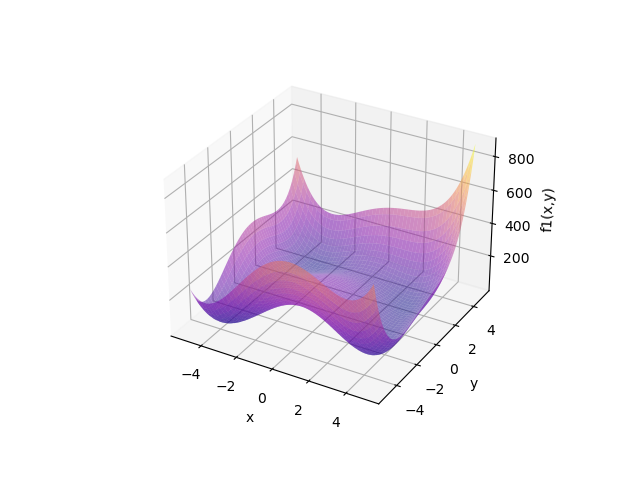

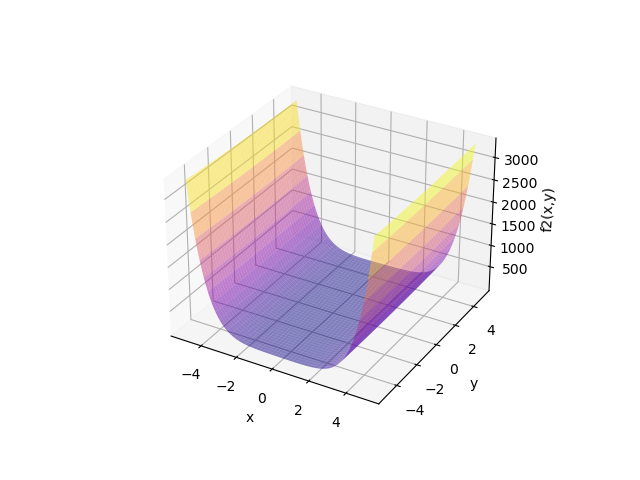

In [67]:
XY = gen_val_to_plot()

Z = f1(XY)
plot_2d_graph(XY, Z, 'f1')


Z = f2(XY)
plot_2d_graph(XY, Z, 'f2')

Function $f_1$ has 4 minima, each of which takes the value $0$ for specific values of $x_1$ and $x_2$. Function $f_2$ has a single minimum at the point $(0,0)$.


# Population distribution in successive generations for $f_1$ and $f_2$

In [68]:
gauss_sigma = 0.01
mutation_rate = 0.01
crossover_rate = 0.5
pop_size = 1000
num_generations = 100
fig, ax = plt.subplots()
x1, y1, x2, y2, population_states = create_animation(pop_size, bounds, num_generations, tournament_size, gauss_sigma, mutation_rate, crossover_rate)

anim_f1 = animation.FuncAnimation(fig, update_plot, frames=len(population_states), fargs=(x1, y1, 'x1', 'y1', 'f1'), interval=50, repeat=False)
anim_f2 = animation.FuncAnimation(fig, update_plot, frames=len(population_states), fargs=(x2, y2, 'x2', 'y2', 'f2'), interval=50, repeat=False)
plt.close()
HTML(anim_f1.to_jshtml() + anim_f2.to_jshtml())

In the population plot for function $f_1$, we can observe that once the population converges to one of the minima, the chances of jumping to another minimum are minimal. This is because the only factor that can cause the population to "jump" from a minimum is the mutation of a gene.

# Population distributions in successive generations for functions $f_1$ and $f_2$ in 3 dimensions

In [69]:
XY=gen_val_to_plot()
Z1=f1(XY)
Z2=f2(XY)
gauss_sigma = 0.01
mutation_rate = 0.01
crossover_rate = 0.5
pop_size = 10000
num_generations = 100
x1, y1, x2, y2, population_states = create_animation(pop_size, bounds, num_generations, tournament_size, gauss_sigma, mutation_rate, crossover_rate)
z1, z2 = [], []
for i in range(len(x1)):
    z1.append(f1([x1[i], y1[i]]))
    z2.append(f2([x2[i], y2[i]]))

fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')

ani_f1 = animation.FuncAnimation(fig, update_plot3d, frames=num_generations, fargs=(x1, y1, z1, 'x1', 'y1', 'f1', XY, Z1), interval=100, repeat=False)
ani_f2 = animation.FuncAnimation(fig, update_plot3d, frames=num_generations, fargs=(x2, y2, z2, 'x2', 'y2', 'f2', XY, Z2), interval=100, repeat=False)
plt.close()
HTML(ani_f1.to_html5_video() + ani_f2.to_html5_video())

# Comparison using Gaussian distribution for initializing initial points $x_1$ and $y_1$

In [70]:
gauss_sigma = 0.01
mutation_rate = 0.01
crossover_rate = 0.5
pop_size = 1000
num_generations = 100
table_size = 10

values_table(table_size, pop_size, bounds, num_generations, tournament_size, gauss_sigma, mutation_rate, crossover_rate)
print('\n')

gauss = True
values_table(table_size, pop_size, bounds, num_generations, tournament_size, gauss_sigma, mutation_rate, crossover_rate, gauss)

|    |       x1 |       y1 |           x2 |           y2 |   f(x1,y1,x2,y2) |
|---:|---------:|---------:|-------------:|-------------:|-----------------:|
|  1 | -3.77937 | -3.28322 | -0.000207417 |  0.000101015 |      2.7121e-07  |
|  2 |  3.58439 | -1.84806 | -8.53871e-05 |  5.83284e-05 |      1.53637e-07 |
|  3 |  2.99996 |  2.00004 |  6.8194e-05  | -0.000173544 |      8.34462e-08 |
|  4 | -3.77918 | -3.28315 |  5.1081e-05  | -0.000540179 |      1.21753e-06 |
|  5 |  3.58417 | -1.84812 |  6.87713e-05 | -0.000118164 |      3.59567e-06 |
|  6 |  3.58468 | -1.85234 | -0.0370543   |  0.0420734   |      0.00321598  |
|  7 | -3.77879 | -3.28281 | -0.00122033  |  0.00155297  |      2.00398e-05 |
|  8 |  3.58468 | -1.84947 |  0.0173144   | -0.0344197   |      0.00121575  |
|  9 |  2.99995 |  2.00003 | -0.000144604 |  0.000170128 |      1.26072e-07 |
| 10 |  3.00009 |  1.99987 | -0.000148814 |  0.000136303 |      3.7199e-07  |


|    |       x1 |       y1 |           x2 |           y2 |   f

We can observe that the Gaussian distribution does not have a significant impact on the coordinates $x_1$ and $y_1$. This is most likely due to the large number of generations, which will eventually cause all points to settle in one minimum.

In [71]:
gauss_sigma = 0.01
mutation_rate = 0.01
crossover_rate = 0.5
pop_size = 1000
num_generations = 100
gauss = True
fig, ax = plt.subplots()
x1, y1, x2, y2, population_states = create_animation(pop_size, bounds, num_generations, tournament_size, gauss_sigma, mutation_rate, crossover_rate, gauss)

anim_f1 = animation.FuncAnimation(fig, update_plot, frames=len(population_states), fargs=(x1, y1, 'x1', 'y1', 'f1'), interval=50, repeat=False)
plt.close()
HTML(anim_f1.to_jshtml())

However, we can notice that Gaussian initialization for the coordinates of function $f_1$ leads to the evolutionary algorithm requiring fewer generations to reach the minimum.

# Results for increased mutation probability to:
- $p_m=0.1$
- $p_m=0.2$
- $p_m=0.5$

In [72]:
gauss_sigma = 0.01
crossover_rate = 0.5
pop_size = 1000
num_generations = 100
table_size = 5

mutation_rate = 0.1
values_table(table_size, pop_size, bounds, num_generations, tournament_size, gauss_sigma, mutation_rate, crossover_rate)
print('\n')
mutation_rate = 0.2
values_table(table_size, pop_size, bounds, num_generations, tournament_size, gauss_sigma, mutation_rate, crossover_rate)
print('\n')
mutation_rate = 0.5
values_table(table_size, pop_size, bounds, num_generations, tournament_size, gauss_sigma, mutation_rate, crossover_rate)

|    |       x1 |       y1 |           x2 |           y2 |   f(x1,y1,x2,y2) |
|---:|---------:|---------:|-------------:|-------------:|-----------------:|
|  1 |  3.00003 |  1.99948 | -0.00160688  |  0.00142566  |      9.29349e-06 |
|  2 |  2.9997  |  2.00009 |  0.000462359 |  0.000564537 |      3.9464e-06  |
|  3 | -2.80501 |  3.13158 | -0.000185779 |  0.000754311 |      3.81474e-06 |
|  4 | -3.77965 | -3.28333 |  0.00165156  | -0.000955622 |      1.09052e-05 |
|  5 |  2.99995 |  2.00011 |  0.000197412 |  0.000710893 |      9.18709e-07 |


|    |       x1 |       y1 |          x2 |          y2 |   f(x1,y1,x2,y2) |
|---:|---------:|---------:|------------:|------------:|-----------------:|
|  1 | -2.80574 |  3.13001 |  0.00297388 | 0.00027129  |      0.000100016 |
|  2 |  3.58555 | -1.84758 | -0.00216912 | 0.000886573 |      8.23846e-05 |
|  3 | -2.80448 |  3.13238 | -0.00272376 | 0.00286516  |      7.54238e-05 |
|  4 |  2.99954 |  2.00028 | -0.00447946 | 0.00487975  |      4.86433e-0

In the presented tables, we can observe that the values become increasingly less accurate as the mutation probability $p_m$ increases. This is because as we approach the minimum with each generation, there is a significant chance of moving away from it by mutating the value.

In [73]:
gauss_sigma = 0.01
crossover_rate = 0.5
pop_size = 1000
num_generations = 100
mutation_rate = 0.5

fig, ax = plt.subplots()
x1, y1, x2, y2, population_states = create_animation(pop_size, bounds, num_generations, tournament_size, gauss_sigma, mutation_rate, crossover_rate, gauss)

anim_f1 = animation.FuncAnimation(fig, update_plot, frames=len(population_states), fargs=(x1, y1, 'x1', 'y1', 'f1'), interval=50, repeat=False)
plt.close()
HTML(anim_f1.to_jshtml())

We can notice in this animation how dynamic the points are despite being closer to the minimum.

# Results for decreased mutation probability:
- $p_m=0.005$
- $p_m=0.001$

In [74]:
gauss_sigma = 0.01
crossover_rate = 0.5
pop_size = 1000
num_generations = 100
table_size = 5

mutation_rate = 0.005
values_table(table_size, pop_size, bounds, num_generations, tournament_size, gauss_sigma, mutation_rate, crossover_rate)
print('\n')
mutation_rate = 0.001
values_table(table_size, pop_size, bounds, num_generations, tournament_size, gauss_sigma, mutation_rate, crossover_rate)

|    |       x1 |       y1 |          x2 |           y2 |   f(x1,y1,x2,y2) |
|---:|---------:|---------:|------------:|-------------:|-----------------:|
|  1 | -2.80529 |  3.1312  |  0.0120658  | -0.0199232   |      0.000449203 |
|  2 |  3.58445 | -1.84797 |  0.00161398 | -0.00189499  |      6.15931e-06 |
|  3 |  3.58392 | -1.85111 |  0.0705277  | -0.108241    |      0.0142113   |
|  4 | -2.80528 |  3.13162 | -0.00054575 | -0.000149014 |      5.21052e-06 |
|  5 |  3.58423 | -1.84773 |  0.00178098 | -0.00384567  |      1.81492e-05 |


|    |      x1 |      y1 |           x2 |           y2 |   f(x1,y1,x2,y2) |
|---:|--------:|--------:|-------------:|-------------:|-----------------:|
|  1 | 3.00292 | 1.99126 | -0.0287243   |  0.0980029   |       0.00953913 |
|  2 | 3.01523 | 1.97801 |  0.0949901   | -0.236937    |       0.0618285  |
|  3 | 2.99704 | 2.01244 | -0.0527242   | -0.0202711   |       0.00928023 |
|  4 | 3.00032 | 1.99939 | -0.000220787 | -8.06194e-06 |       6.3351e-06 |
|  

On the other hand, by decreasing the value of $p_m$, we make it so that the algorithm is unable to mutate within a certain number of generations to reach the smallest minimum.

In [75]:
gauss_sigma = 0.01
crossover_rate = 0.5
pop_size = 1000
num_generations = 100
mutation_rate = 0.001

fig, ax = plt.subplots()
x1, y1, x2, y2, population_states = create_animation(pop_size, bounds, num_generations, tournament_size, gauss_sigma, mutation_rate, crossover_rate, gauss)

anim_f1 = animation.FuncAnimation(fig, update_plot, frames=len(population_states), fargs=(x1, y1, 'x1', 'y1', 'f1'), interval=50, repeat=False)
plt.close()
HTML(anim_f1.to_jshtml())

# The impact of changing the variance $\sigma^2$ for the Gaussian distribution during gene mutation. Results for:
- $\sigma^2=0.1$
- $\sigma^2=0.2$
- $\sigma^2=0.5$

In [76]:
mutation_rate = 0.01
crossover_rate = 0.5
pop_size = 1000
num_generations = 100
table_size = 5


gauss_sigma = 0.1
values_table(table_size, pop_size, bounds, num_generations, tournament_size, gauss_sigma, mutation_rate, crossover_rate)
print('\n')
gauss_sigma = 0.2
values_table(table_size, pop_size, bounds, num_generations, tournament_size, gauss_sigma, mutation_rate, crossover_rate)
print('\n')
gauss_sigma = 0.5
values_table(table_size, pop_size, bounds, num_generations, tournament_size, gauss_sigma, mutation_rate, crossover_rate)

|    |       x1 |       y1 |           x2 |           y2 |   f(x1,y1,x2,y2) |
|---:|---------:|---------:|-------------:|-------------:|-----------------:|
|  1 |  3.0004  |  1.99971 | -0.000673008 |  0.000152831 |      5.77585e-06 |
|  2 |  3.58444 | -1.84843 |  0.000743784 | -0.000532649 |      2.36371e-06 |
|  3 |  3.58385 | -1.84687 | -0.000629652 |  0.00181847  |      3.87012e-05 |
|  4 | -2.80548 |  3.13132 | -0.000153119 |  9.51284e-05 |      4.2621e-06  |
|  5 |  3.00022 |  2.00007 | -0.000447851 |  0.000951877 |      2.99017e-06 |


|    |      x1 |       y1 |           x2 |           y2 |   f(x1,y1,x2,y2) |
|---:|--------:|---------:|-------------:|-------------:|-----------------:|
|  1 | 3.58428 | -1.84774 |  0.000109647 |  0.000862146 |      3.89181e-06 |
|  2 | 3.0005  |  1.99857 | -0.000268305 | -0.00102476  |      3.12845e-05 |
|  3 | 2.9996  |  2.00153 |  0.00103446  |  0.00170155  |      4.04351e-05 |
|  4 | 3.58308 | -1.84927 |  0.00191215  |  0.0012388   |      0.00

Increasing the variance leads to worse results. As the variance increases, the standard deviation also increases, resulting in a larger distribution of the sampled values.

In [77]:
mutation_rate = 0.01
gauss_sigma = 0.5
crossover_rate = 0.5
pop_size = 1000
num_generations = 100

fig, ax = plt.subplots()
x1, y1, x2, y2, population_states = create_animation(pop_size, bounds, num_generations, tournament_size, gauss_sigma, mutation_rate, crossover_rate, gauss)

anim_f1 = animation.FuncAnimation(fig, update_plot, frames=len(population_states), fargs=(x1, y1, 'x1', 'y1', 'f1'), interval=50, repeat=False)
plt.close()
HTML(anim_f1.to_jshtml())

The animation above illustrates this well, showing the significant impact of increasing $\sigma^2$. The points "jump" over larger distances, unable to reach the minimum.

In [78]:
mutation_rate = 0.01
gauss_sigma = 2
crossover_rate = 0.5
pop_size = 1000
num_generations = 100

fig, ax = plt.subplots()
x1, y1, x2, y2, population_states = create_animation(pop_size, bounds, num_generations, tournament_size, gauss_sigma, mutation_rate, crossover_rate, gauss)

anim_f1 = animation.FuncAnimation(fig, update_plot, frames=len(population_states), fargs=(x1, y1, 'x1', 'y1', 'f1'), interval=50, repeat=False)
plt.close()
HTML(anim_f1.to_jshtml())

For $\sigma^2=2$, we can observe that some points "jump" to other minima.

# The impact of increasing the variance on changing the result for:
- $\sigma^2=0.001$
- $\sigma^2=0.0001$

In [79]:
mutation_rate = 0.01
crossover_rate = 0.5
pop_size = 1000
num_generations = 100
table_size = 5

gauss_sigma = 0.001
values_table(table_size, pop_size, bounds, num_generations, tournament_size, gauss_sigma, mutation_rate, crossover_rate)
print('\n')
gauss_sigma = 0.0001
values_table(table_size, pop_size, bounds, num_generations, tournament_size, gauss_sigma, mutation_rate, crossover_rate)

|    |       x1 |       y1 |          x2 |           y2 |   f(x1,y1,x2,y2) |
|---:|---------:|---------:|------------:|-------------:|-----------------:|
|  1 | -3.82863 | -3.28626 | -0.0202835  |  0.10297     |        0.148703  |
|  2 | -3.72623 | -3.25225 | -0.00774899 | -0.000998042 |        0.15739   |
|  3 |  3.01099 |  1.97064 | -0.00110914 |  0.0391215   |        0.0139846 |
|  4 | -2.76457 |  3.18213 |  0.062915   | -0.0356716   |        0.168204  |
|  5 |  2.982   |  2.04468 | -0.0423145  |  0.0393417   |        0.0339143 |


|    |       x1 |      y1 |         x2 |         y2 |   f(x1,y1,x2,y2) |
|---:|---------:|--------:|-----------:|-----------:|-----------------:|
|  1 | -2.76319 | 3.06116 |  0.0197406 |  0.229     |        0.304     |
|  2 |  2.99802 | 1.96341 | -0.102279  |  0.0803811 |        0.0432413 |
|  3 |  2.99313 | 1.97796 | -0.245226  |  0.0317455 |        0.130261  |
|  4 |  2.93052 | 2.11011 | -0.0476229 |  0.0673839 |        0.243773  |
|  5 |  2.98216 | 2.0

Decreasing the variance, on the other hand, causes the points to be less dynamic, meaning they require more generations to reach the minimum.

In [80]:
mutation_rate = 0.01
gauss_sigma = 0.0001
crossover_rate = 0.5
pop_size = 1000
num_generations = 100

fig, ax = plt.subplots()
x1, y1, x2, y2, population_states = create_animation(pop_size, bounds, num_generations, tournament_size, gauss_sigma, mutation_rate, crossover_rate, gauss)

anim_f1 = animation.FuncAnimation(fig, update_plot, frames=len(population_states), fargs=(x1, y1, 'x1', 'y1', 'f1'), interval=50, repeat=False)
plt.close()
HTML(anim_f1.to_jshtml())

# The impact of increasing the crossover probability $p_c$ on the coordinates of $f_1$. Tests for values:
- $p_c=0.7$
- $p_c=0.8$
- $p_c=0.9$

In [81]:
mutation_rate = 0.01
gauss_sigma = 0.01
crossover_rate = 0.5
pop_size = 1000
num_generations = 100
table_size = 5


crossover_rate = 0.7
values_table(table_size, pop_size, bounds, num_generations, tournament_size, gauss_sigma, mutation_rate, crossover_rate)
print('\n')
crossover_rate = 0.8
values_table(table_size, pop_size, bounds, num_generations, tournament_size, gauss_sigma, mutation_rate, crossover_rate)
print('\n')
crossover_rate = 0.9
values_table(table_size, pop_size, bounds, num_generations, tournament_size, gauss_sigma, mutation_rate, crossover_rate)

|    |       x1 |       y1 |           x2 |           y2 |   f(x1,y1,x2,y2) |
|---:|---------:|---------:|-------------:|-------------:|-----------------:|
|  1 |  3.58418 | -1.84796 |  0.0003705   | -0.000621882 |      3.75669e-06 |
|  2 |  2.99998 |  2.00003 | -1.18387e-05 |  6.7778e-05  |      2.39678e-08 |
|  3 |  2.99999 |  2.00007 | -8.138e-05   |  9.20269e-05 |      9.84586e-08 |
|  4 | -2.80498 |  3.1312  |  0.000476308 | -0.00116126  |      2.32659e-06 |
|  5 |  3.00082 |  1.99586 | -0.0393491   |  0.155001    |      0.0212732   |


|    |       x1 |       y1 |           x2 |           y2 |   f(x1,y1,x2,y2) |
|---:|---------:|---------:|-------------:|-------------:|-----------------:|
|  1 |  3.00002 |  2       |  8.09612e-05 | -7.94549e-05 |      2.64104e-08 |
|  2 |  3.58422 | -1.84858 |  0.000323264 |  0.000877313 |      7.38234e-06 |
|  3 | -2.8049  |  3.13128 | -3.81057e-05 |  0.000124254 |      1.64433e-06 |
|  4 | -3.77932 | -3.28327 |  4.06505e-05 |  5.00981e-05 |    

Increasing the crossover probability does not have a significant impact on changing the final coordinate values.

In [82]:
mutation_rate = 0.01
gauss_sigma = 0.01
crossover_rate = 0.9
pop_size = 1000
num_generations = 100

fig, ax = plt.subplots()
x1, y1, x2, y2, population_states = create_animation(pop_size, bounds, num_generations, tournament_size, gauss_sigma, mutation_rate, crossover_rate, gauss)

anim_f1 = animation.FuncAnimation(fig, update_plot, frames=len(population_states), fargs=(x1, y1, 'x1', 'y1', 'f1'), interval=50, repeat=False)
plt.close()
HTML(anim_f1.to_jshtml())

Also, there are no significant differences observable in individual populations.

# Results for decreased crossover probability $p_c$, for values:
- $p_c=0.3$
- $p_c=0.1$

In [83]:
mutation_rate = 0.01
gauss_sigma = 0.01
crossover_rate = 0.5
pop_size = 1000
num_generations = 100
table_size = 5


crossover_rate = 0.3
values_table(table_size, pop_size, bounds, num_generations, tournament_size, gauss_sigma, mutation_rate, crossover_rate)
print('\n')
crossover_rate = 0.1
values_table(table_size, pop_size, bounds, num_generations, tournament_size, gauss_sigma, mutation_rate, crossover_rate)

|    |       x1 |       y1 |           x2 |           y2 |   f(x1,y1,x2,y2) |
|---:|---------:|---------:|-------------:|-------------:|-----------------:|
|  1 |  2.99984 |  2.00029 |  0.00173569  | -0.00287759  |      1.0749e-05  |
|  2 |  3.58445 | -1.84807 |  0.000151891 |  8.84466e-05 |      1.45096e-07 |
|  3 |  3.58487 | -1.84692 | -0.0650561   |  0.186712    |      0.031233    |
|  4 | -2.80491 |  3.1311  |  0.00784867  | -0.00711941  |      0.000121275 |
|  5 |  3.00001 |  2.00014 | -8.10112e-05 |  0.000260472 |      4.09549e-07 |


|    |       x1 |       y1 |          x2 |          y2 |   f(x1,y1,x2,y2) |
|---:|---------:|---------:|------------:|------------:|-----------------:|
|  1 |  3.00287 |  1.99376 | -0.283811   |  0.13332    |      0.148541    |
|  2 | -2.80969 |  3.13696 |  0.0752121  | -0.222005   |      0.0458664   |
|  3 | -2.80507 |  3.13114 | -0.00100232 | -0.00051258 |      4.07245e-06 |
|  4 | -2.80712 |  3.13304 |  0.0335821  | -0.103414   |      0.00972343

Decreasing the crossover probability, on the other hand, results in less accurate outcomes.

In [84]:
mutation_rate = 0.01
gauss_sigma = 0.01
crossover_rate = 0.1
pop_size = 1000
num_generations = 100

fig, ax = plt.subplots()
x1, y1, x2, y2, population_states = create_animation(pop_size, bounds, num_generations, tournament_size, gauss_sigma, mutation_rate, crossover_rate, gauss)

anim_f1 = animation.FuncAnimation(fig, update_plot, frames=len(population_states), fargs=(x1, y1, 'x1', 'y1', 'f1'), interval=50, repeat=False)
plt.close()
HTML(anim_f1.to_jshtml())

We can observe that the population is much more scattered, points do not cross each other, thus they do not converge towards the minimum at the appropriate pace.

# Conclusions:
- Genetic algorithms require tuning a large number of parameters to produce relatively good results.
- Decreasing parameters such as $p_m$ and $\sigma^2$ necessitates increasing the number of generations to obtain good results.
- As we approach the minimum, the subsequent generations of points decrease their step, making it unlikely for points to "jump" to another local minimum. This implies that if we want to discover all minima, we need to run the algorithm several times.